### density_var_score

各配置下的密度变异得分:
--------------------------------------------------
配置参数                                     均匀分布         集中分布         稀疏分布        
--------------------------------------------------
kernel=gaussian, bandwidth=0.05              125.57       59.75       82.39
kernel=gaussian, bandwidth=0.1                58.71       61.13       81.57
kernel=gaussian, bandwidth=0.2                38.59       54.78       77.74
kernel=epanechnikov, bandwidth=0.1           140.82       54.47       83.73
kernel=gaussian, bandwidth=scott              46.64       51.61       56.13
kernel=gaussian, bandwidth=silverman          46.64       51.61       56.13


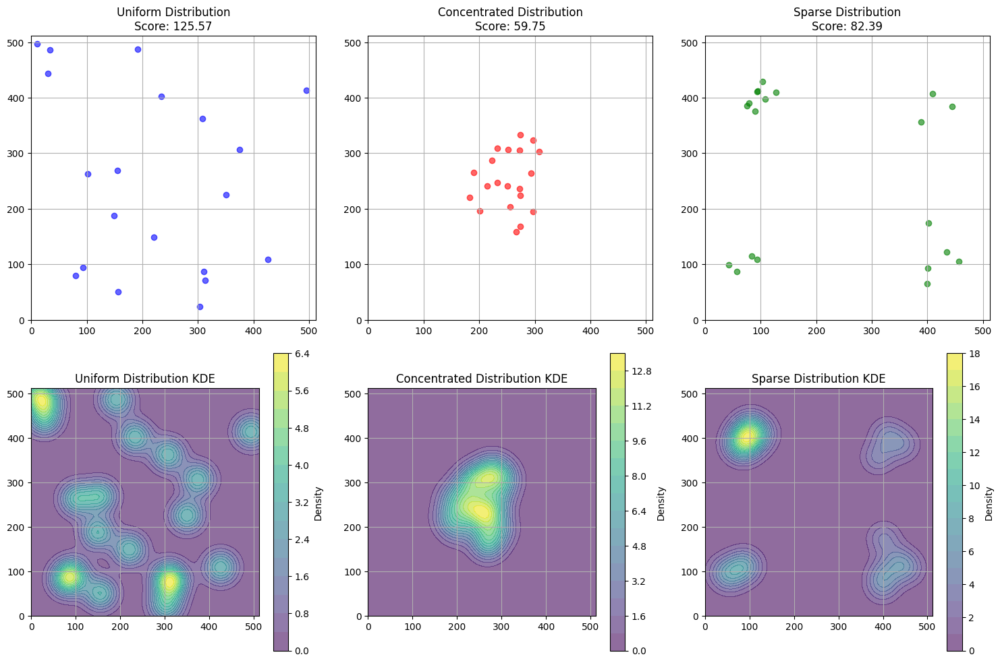

In [30]:
import numpy as np
from sklearn.neighbors import KernelDensity
import matplotlib.pyplot as plt

def calculate_density_score(centers, config):
    if len(centers) > 1:
        # 归一化坐标
        centers_normalized = centers / 512.0
        
        kde = KernelDensity(**config).fit(centers_normalized)
        log_densities = kde.score_samples(centers_normalized)
        densities = np.exp(log_densities)
        
        # 归一化密度值
        normalized_densities = (densities - np.min(densities)) / (np.max(densities) - np.min(densities) + 1e-6)
        
        # 计算变异系数
        density_mean = np.mean(normalized_densities) + 1e-6
        score = np.std(normalized_densities) / density_mean * 100
        return score

def plot_kde_density(ax, points, config):
    """绘制核密度估计图"""
    # 归一化坐标
    points_normalized = points / 512.0
    
    # 创建网格点
    x_grid = np.linspace(0, 1, 100)
    y_grid = np.linspace(0, 1, 100)
    X_grid, Y_grid = np.meshgrid(x_grid, y_grid)
    grid_points = np.vstack([X_grid.ravel(), Y_grid.ravel()]).T
    
    # 拟合KDE并计算密度
    kde = KernelDensity(**config).fit(points_normalized)
    log_densities = kde.score_samples(grid_points)
    densities = np.exp(log_densities).reshape(X_grid.shape)
    
    # 绘制等高线图
    contour = ax.contourf(X_grid * 512, Y_grid * 512, densities, 
                         levels=20, cmap='viridis', alpha=0.6)
    return contour

# 生成三种不同分布的点
np.random.seed(42)

# 1. 均匀分布的点
uniform_points = np.random.uniform(0, 512, size=(20, 2))

# 2. 集中分布的点
center = np.array([256, 256])
concentrated_points = np.random.normal(loc=center, scale=50, size=(20, 2))
concentrated_points = np.clip(concentrated_points, 0, 512)

# 3. 稀疏分布的点
sparse_centers = np.array([[100, 100], [400, 400], [100, 400], [400, 100]])
cluster_indices = np.random.choice(len(sparse_centers), size=20)
sparse_points = sparse_centers[cluster_indices] + np.random.normal(0, 30, size=(20, 2))
sparse_points = np.clip(sparse_points, 0, 512)

# KDE配置
kde_configs = [
    {'kernel': 'gaussian', 'bandwidth': 0.05},  # 较小带宽
    {'kernel': 'gaussian', 'bandwidth': 0.1},   # 中等带宽
    {'kernel': 'gaussian', 'bandwidth': 0.2},   # 较大带宽
    {'kernel': 'epanechnikov', 'bandwidth': 0.1},  # 不同核函数
    {'kernel': 'gaussian', 'bandwidth': 'scott'},  # Scott规则
    {'kernel': 'gaussian', 'bandwidth': 'silverman'}  # Silverman规则
]

# 打印不同配置的得分
print("各配置下的密度变异得分:")
print("-" * 50)
print(f"{'配置参数':<40} {'均匀分布':<12} {'集中分布':<12} {'稀疏分布':<12}")
print("-" * 50)

for config in kde_configs:
    uniform_score = calculate_density_score(uniform_points, config)
    concentrated_score = calculate_density_score(concentrated_points, config)
    sparse_score = calculate_density_score(sparse_points, config)
    
    config_str = f"kernel={config['kernel']}, bandwidth={config['bandwidth']}"
    print(f"{config_str:<40} {uniform_score:>10.2f}  {concentrated_score:>10.2f}  {sparse_score:>10.2f}")

# 创建两行图：上行显示散点图，下行显示密度图
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# 使用第一个配置进行可视化
config = kde_configs[0]

# 上行：散点图
# 均匀分布
axes[0,0].scatter(uniform_points[:, 0], uniform_points[:, 1], c='blue', alpha=0.6)
axes[0,0].set_title(f'Uniform Distribution\nScore: {calculate_density_score(uniform_points, config):.2f}')

# 集中分布
axes[0,1].scatter(concentrated_points[:, 0], concentrated_points[:, 1], c='red', alpha=0.6)
axes[0,1].set_title(f'Concentrated Distribution\nScore: {calculate_density_score(concentrated_points, config):.2f}')

# 稀疏分布
axes[0,2].scatter(sparse_points[:, 0], sparse_points[:, 1], c='green', alpha=0.6)
axes[0,2].set_title(f'Sparse Distribution\nScore: {calculate_density_score(sparse_points, config):.2f}')

# 下行：密度图
contour1 = plot_kde_density(axes[1,0], uniform_points, config)
axes[1,0].set_title('Uniform Distribution KDE')

contour2 = plot_kde_density(axes[1,1], concentrated_points, config)
axes[1,1].set_title('Concentrated Distribution KDE')

contour3 = plot_kde_density(axes[1,2], sparse_points, config)
axes[1,2].set_title('Sparse Distribution KDE')

# 添加颜色条
plt.colorbar(contour1, ax=axes[1,0], label='Density')
plt.colorbar(contour2, ax=axes[1,1], label='Density')
plt.colorbar(contour3, ax=axes[1,2], label='Density')

# 设置所有子图的属性
for ax_row in axes:
    for ax in ax_row:
        ax.set_xlim(0, 512)
        ax.set_ylim(0, 512)
        ax.set_aspect('equal')
        ax.grid(True)

plt.tight_layout()
plt.show()

- 寻找最优参数
（1） 根据理论，集中分布的有更高的变异系数

最优参数配置:
Kernel: epanechnikov
Bandwidth: 0.0306

得分:
均匀分布: 0.00
集中分布: 203.65
稀疏分布: 163.47
得分差异: 40.18

各核函数的最佳结果:

Kernel: gaussian
最佳带宽: 1.0254
均匀分布得分: 48.51
集中分布得分: 51.34
稀疏分布得分: 48.50
得分差异: 2.83

Kernel: epanechnikov
最佳带宽: 0.0306
均匀分布得分: 0.00
集中分布得分: 203.65
稀疏分布得分: 163.47
得分差异: 40.18

Kernel: exponential
最佳带宽: 0.0608
均匀分布得分: 76.98
集中分布得分: 73.34
稀疏分布得分: 85.59
得分差异: -12.25

Kernel: linear
最佳带宽: 0.0306
均匀分布得分: 0.00
集中分布得分: 204.58
稀疏分布得分: 173.21
得分差异: 31.38

Kernel: cosine
最佳带宽: 0.0306
均匀分布得分: 0.00
集中分布得分: 204.30
稀疏分布得分: 166.21
得分差异: 38.08


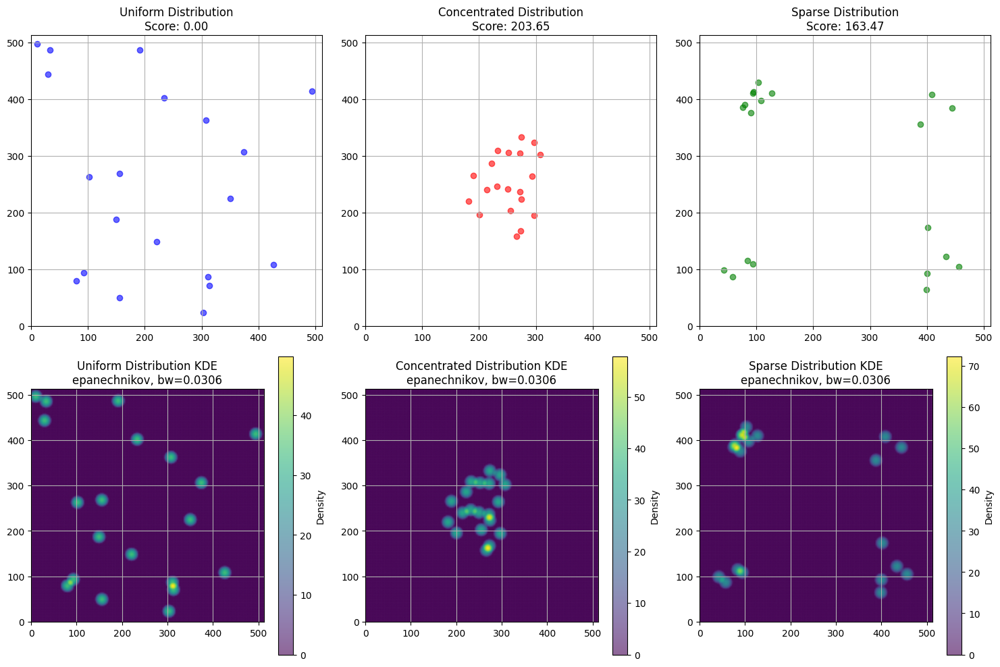

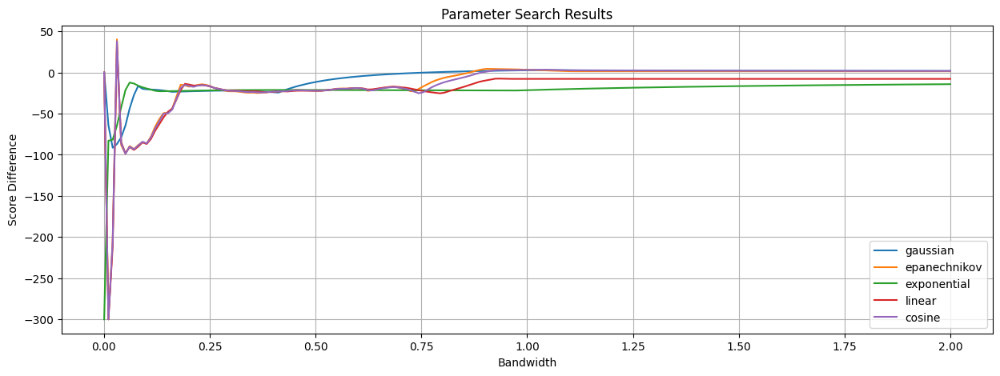

In [86]:
import numpy as np
from sklearn.neighbors import KernelDensity
import matplotlib.pyplot as plt

def calculate_density_score(centers, config):
    if len(centers) > 1:
        # 归一化坐标
        centers_normalized = centers / 512.0
        
        kde = KernelDensity(**config).fit(centers_normalized)
        log_densities = kde.score_samples(centers_normalized)
        densities = np.exp(log_densities)
        # normalized_densities =densities
        # 归一化密度值
        normalized_densities = (densities - np.min(densities)) / (np.max(densities) - np.min(densities) + 1e-6)
        
        # 计算变异系数
        density_mean = np.mean(normalized_densities) + 1e-6
        score = np.std(normalized_densities) / density_mean * 100
        return score
    else:
        return 0.0

def plot_kde_density(ax, points, config):
    """绘制核密度估计图"""
    # 归一化坐标
    points_normalized = points / 512.0
    
    # 创建网格点
    x_grid = np.linspace(0, 1, 200)
    y_grid = np.linspace(0, 1, 200)
    X_grid, Y_grid = np.meshgrid(x_grid, y_grid)
    grid_points = np.vstack([X_grid.ravel(), Y_grid.ravel()]).T
    
    # 拟合KDE并计算密度
    kde = KernelDensity(**config).fit(points_normalized)
    log_densities = kde.score_samples(grid_points)
    densities = np.exp(log_densities).reshape(X_grid.shape)

        
    # 使用pcolormesh来获得更平滑的效果
    contour = ax.pcolormesh(X_grid * 512, Y_grid * 512, densities, 
                           cmap='viridis', alpha=0.6, shading='gouraud')
    
    # # 绘制等高线图
    # contour = ax.contourf(X_grid * 512, Y_grid * 512, densities, 
    #                      levels=20, cmap='viridis', alpha=0.6)
    return contour




# 生成三种不同分布的点
np.random.seed(42)

# 1. 均匀分布的点
uniform_points = np.random.uniform(0, 512, size=(20, 2))

# 2. 集中分布的点
center = np.array([256, 256])
concentrated_points = np.random.normal(loc=center, scale=50, size=(20, 2))
concentrated_points = np.clip(concentrated_points, 0, 512)

# 3. 稀疏分布的点
sparse_centers = np.array([[100, 100], [400, 400], [100, 400], [400, 100]])
cluster_indices = np.random.choice(len(sparse_centers), size=20)
sparse_points = sparse_centers[cluster_indices] + np.random.normal(0, 30, size=(20, 2))
sparse_points = np.clip(sparse_points, 0, 512)

# 参数搜索空间
kernels = ['gaussian', 'epanechnikov', 'exponential', 'linear', 'cosine']
# bandwidths = np.linspace(0.01, 0.8, 50)  # 更细致的带宽搜索  #最佳的
bandwidths = np.linspace(0.0005,2, 200)  # 更细致的带宽搜索  


# 存储所有结果
all_results = []

# 参数搜索
for kernel in kernels:
    for bandwidth in bandwidths:
        config = {'kernel': kernel, 'bandwidth': bandwidth}
        
        # 计算三种分布的得分
        uniform_score = calculate_density_score(uniform_points, config)
        concentrated_score = calculate_density_score(concentrated_points, config)
        sparse_score = calculate_density_score(sparse_points, config)
        
        # 计算得分差异（集中分布应该最高）
        score_diff = concentrated_score - max(uniform_score, sparse_score)
        
        all_results.append({
            'kernel': kernel,
            'bandwidth': bandwidth,
            'uniform_score': uniform_score,
            'concentrated_score': concentrated_score,
            'sparse_score': sparse_score,
            'score_diff': score_diff
        })

# 找到最优参数（使集中分布得分最高的配置）
best_result = max(all_results, key=lambda x: x['score_diff'])

print("最优参数配置:")
print(f"Kernel: {best_result['kernel']}")
print(f"Bandwidth: {best_result['bandwidth']:.4f}")
print("\n得分:")
print(f"均匀分布: {best_result['uniform_score']:.2f}")
print(f"集中分布: {best_result['concentrated_score']:.2f}")
print(f"稀疏分布: {best_result['sparse_score']:.2f}")
print(f"得分差异: {best_result['score_diff']:.2f}")

# 分析不同kernel的最佳结果
print("\n各核函数的最佳结果:")
for kernel in kernels:
    kernel_results = [r for r in all_results if r['kernel'] == kernel]
    best_kernel_result = max(kernel_results, key=lambda x: x['score_diff'])
    
    print(f"\nKernel: {kernel}")
    print(f"最佳带宽: {best_kernel_result['bandwidth']:.4f}")
    print(f"均匀分布得分: {best_kernel_result['uniform_score']:.2f}")
    print(f"集中分布得分: {best_kernel_result['concentrated_score']:.2f}")
    print(f"稀疏分布得分: {best_kernel_result['sparse_score']:.2f}")
    print(f"得分差异: {best_kernel_result['score_diff']:.2f}")

# 使用最优参数创建可视化
best_config = {
    'kernel': best_result['kernel'],
    'bandwidth': best_result['bandwidth']
}

# 创建两行图：上行显示散点图，下行显示密度图
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# 上行：散点图
# 均匀分布
axes[0,0].scatter(uniform_points[:, 0], uniform_points[:, 1], c='blue', alpha=0.6)
axes[0,0].set_title(f'Uniform Distribution\nScore: {best_result["uniform_score"]:.2f}')

# 集中分布
axes[0,1].scatter(concentrated_points[:, 0], concentrated_points[:, 1], c='red', alpha=0.6)
axes[0,1].set_title(f'Concentrated Distribution\nScore: {best_result["concentrated_score"]:.2f}')

# 稀疏分布
axes[0,2].scatter(sparse_points[:, 0], sparse_points[:, 1], c='green', alpha=0.6)
axes[0,2].set_title(f'Sparse Distribution\nScore: {best_result["sparse_score"]:.2f}')

# 下行：密度图
contour1 = plot_kde_density(axes[1,0], uniform_points, best_config)
axes[1,0].set_title(f'Uniform Distribution KDE\n{best_config["kernel"]}, bw={best_config["bandwidth"]:.4f}')

contour2 = plot_kde_density(axes[1,1], concentrated_points, best_config)
axes[1,1].set_title(f'Concentrated Distribution KDE\n{best_config["kernel"]}, bw={best_config["bandwidth"]:.4f}')

contour3 = plot_kde_density(axes[1,2], sparse_points, best_config)
axes[1,2].set_title(f'Sparse Distribution KDE\n{best_config["kernel"]}, bw={best_config["bandwidth"]:.4f}')

# 添加颜色条
plt.colorbar(contour1, ax=axes[1,0], label='Density')
plt.colorbar(contour2, ax=axes[1,1], label='Density')
plt.colorbar(contour3, ax=axes[1,2], label='Density')

# 设置所有子图的属性
for ax_row in axes:
    for ax in ax_row:
        ax.set_xlim(0, 512)
        ax.set_ylim(0, 512)
        ax.set_aspect('equal')
        ax.grid(True)

plt.tight_layout()
plt.show()

# 可视化参数搜索结果
plt.figure(figsize=(15, 5))
for kernel in kernels:
    kernel_results = [r for r in all_results if r['kernel'] == kernel]
    bandwidths = [r['bandwidth'] for r in kernel_results]
    score_diffs = [r['score_diff'] for r in kernel_results]
    
    plt.plot(bandwidths, score_diffs, label=kernel)

plt.xlabel('Bandwidth')
plt.ylabel('Score Difference')
plt.title('Parameter Search Results')
plt.legend()
plt.grid(True)
plt.show()

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


/tmp/ipykernel_206724/3288045170.py:123: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


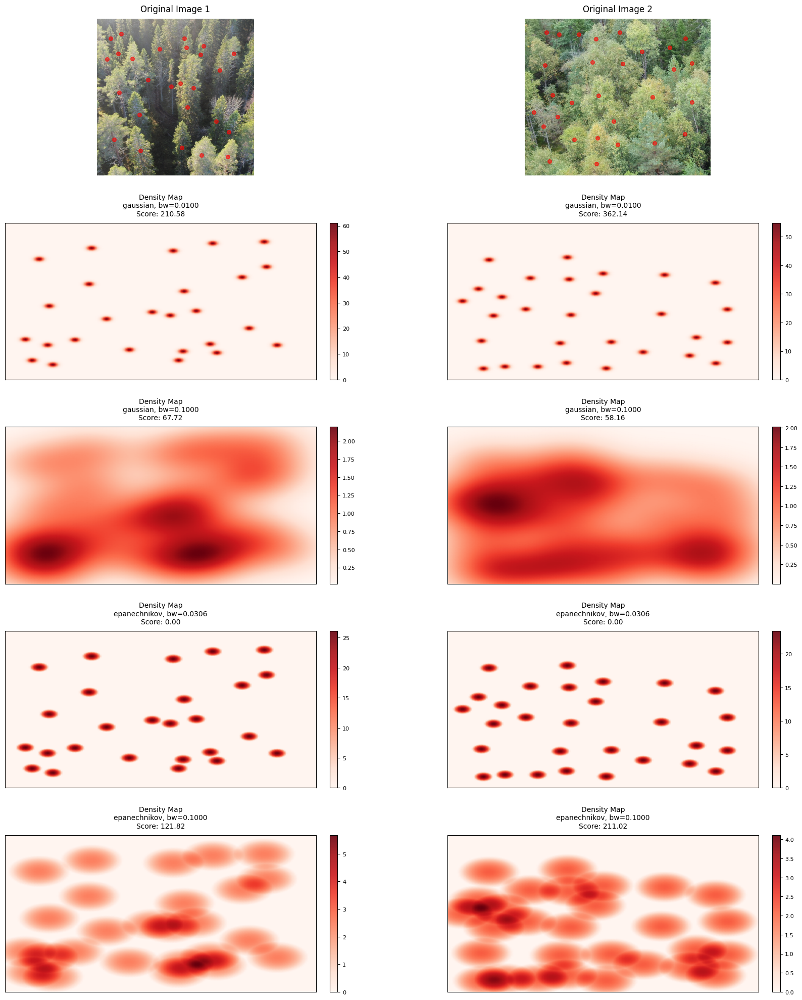

In [97]:
import numpy as np
from sklearn.neighbors import KernelDensity
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import os
from PIL import Image
import random

def load_coco_data(image_dir, annotation_file, n=10):
    """加载COCO格式数据"""
    coco = COCO(annotation_file)
    img_ids = coco.getImgIds()
    selected_img_ids = random.sample(img_ids, min(n, len(img_ids)))
    
    selected_images = []
    
    for img_id in selected_img_ids:
        img_info = coco.loadImgs(img_id)[0]
        img_path = os.path.join(image_dir, img_info['file_name'])
        
        ann_ids = coco.getAnnIds(imgIds=img_id)
        anns = coco.loadAnns(ann_ids)
        
        centers = []
        for ann in anns:
            bbox = ann['bbox']
            center_x = bbox[0] + bbox[2]/2
            center_y = bbox[1] + bbox[3]/2
            centers.append([center_x, center_y])
        
        if centers:
            selected_images.append({
                'path': img_path,
                'width': img_info['width'],
                'height': img_info['height'],
                'centers': np.array(centers)
            })
    
    return selected_images

def plot_kde_density(ax, points, config, img_shape):
    """绘制更平滑的核密度估计图"""
    points_normalized = points / max(img_shape)
    
    # 增加网格密度以获得更平滑的效果
    x_grid = np.linspace(0, 1, 200)
    y_grid = np.linspace(0, 1, 200)
    X_grid, Y_grid = np.meshgrid(x_grid, y_grid)
    grid_points = np.vstack([X_grid.ravel(), Y_grid.ravel()]).T
    
    # 拟合KDE并计算密度
    kde = KernelDensity(**config).fit(points_normalized)
    log_densities = kde.score_samples(grid_points)
    densities = np.exp(log_densities).reshape(X_grid.shape)
    
    # 使用改进的颜色映射和平滑效果
    contour = ax.pcolormesh(X_grid * img_shape[1], Y_grid * img_shape[0], 
                           densities, 
                           cmap='Reds',  # 或者尝试 'YlOrRd', 'hot', 'RdPu'
                           alpha=0.9,    # 增加不透明度
                           shading='gouraud',  # 平滑渲染
                           rasterized=True)    # 更好的渲染质量
    
    return contour

def calculate_density_score(centers, config, img_shape):
    """计算密度分数"""
    if len(centers) > 1:
        centers_normalized = centers / max(img_shape)
        kde = KernelDensity(**config).fit(centers_normalized)
        log_densities = kde.score_samples(centers_normalized)
        densities = np.exp(log_densities)
        normalized_densities = (densities - np.min(densities)) / (np.max(densities) - np.min(densities) + 1e-6)
        density_mean = np.mean(normalized_densities) + 1e-6
        score = np.std(normalized_densities) / density_mean * 100
        return score
    return 0.0

def visualize_with_params(images, configs, rows=2):
    """使用不同参数可视化同一组图片"""
    n_images = len(images)
    n_configs = len(configs)
    
    # 创建图形，增加间距
    fig = plt.figure(figsize=(20, 5 * (n_configs + 1)))
    gs = fig.add_gridspec(n_configs + 1, rows, hspace=0.3, wspace=0.3)
    
    # 在第一行显示原始图片和标注
    for i, img_info in enumerate(images[:rows]):
        ax = fig.add_subplot(gs[0, i])
        img = Image.open(img_info['path'])
        ax.imshow(img)
        ax.scatter(img_info['centers'][:, 0], img_info['centers'][:, 1], 
                  c='red', alpha=0.6, s=30, marker='o')
        ax.set_title(f'Original Image {i+1}', pad=10, fontsize=12)
        ax.axis('off')  # 隐藏坐标轴
    
    # 在后续行显示不同参数的密度图
    for i, config in enumerate(configs, 1):
        for j, img_info in enumerate(images[:rows]):
            ax = fig.add_subplot(gs[i, j])
            img_shape = (img_info['height'], img_info['width'])
            score = calculate_density_score(img_info['centers'], config, img_shape)
            
            # 绘制密度图
            contour = plot_kde_density(ax, img_info['centers'], config, img_shape)
            
            # 设置标题
            title = f'Density Map\n{config["kernel"]}, bw={config["bandwidth"]:.4f}\nScore: {score:.2f}'
            ax.set_title(title, pad=10, fontsize=10)
            
            # 添加颜色条并设置其样式
            cbar = plt.colorbar(contour, ax=ax, fraction=0.046, pad=0.04)
            cbar.ax.tick_params(labelsize=8)
            
            # 设置轴范围和样式
            ax.set_xlim(0, img_shape[1])
            ax.set_ylim(0, img_shape[0])
            ax.grid(False)  # 移除网格线
            ax.set_xticks([])  # 移除x轴刻度
            ax.set_yticks([])  # 移除y轴刻度
    
    plt.tight_layout()
    plt.show()


def main(image_dir, annotation_file, n=10):
    # 加载数据
    selected_images = load_coco_data(image_dir, annotation_file, n)
    
    # 定义不同的参数配置
    configs = [
        {'kernel': 'gaussian', 'bandwidth': 0.01},
        {'kernel': 'gaussian', 'bandwidth': 0.1},
        {'kernel': 'epanechnikov', 'bandwidth': 0.0306},
        {'kernel': 'epanechnikov', 'bandwidth': 0.1}
    ]
    
    # 可视化结果
    visualize_with_params(selected_images, configs, rows=2)

if __name__ == "__main__":
    image_dir = "data/ForestDamages/active_learning_ssc/images_labeled_train"
    annotation_file = "data/ForestDamages/active_learning_ssc/annotations/instances_labeled_train.json"
    main(image_dir, annotation_file, n=2)

###  area_var_score
- 生成的第三个图"Area Ratio to Max Area"：
    - X轴是边界框的索引（Box Index），从0到边界框总数
    - Y轴是每个边界框的面积与最大可能面积（图片面积）的比值
    - 每个蓝点代表一个边界框的面积比例
    - 点按面积比例从小到大排序显示

    ！ Area Ratio = 单个边界框面积 / 图片总面积

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Area_var_score: 1.84


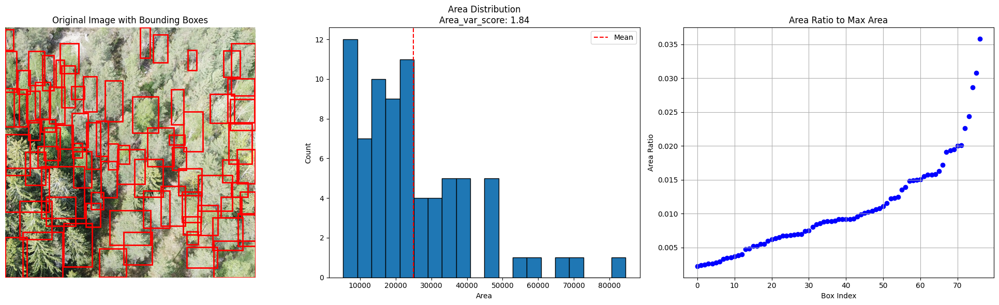

Area_var_score: 30.89


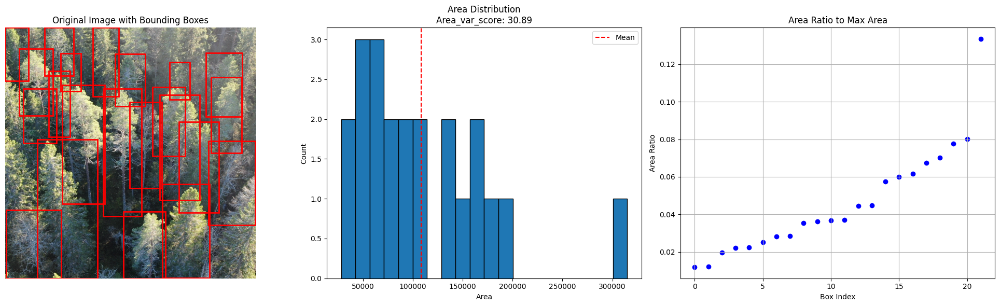

Area_var_score: 7.01


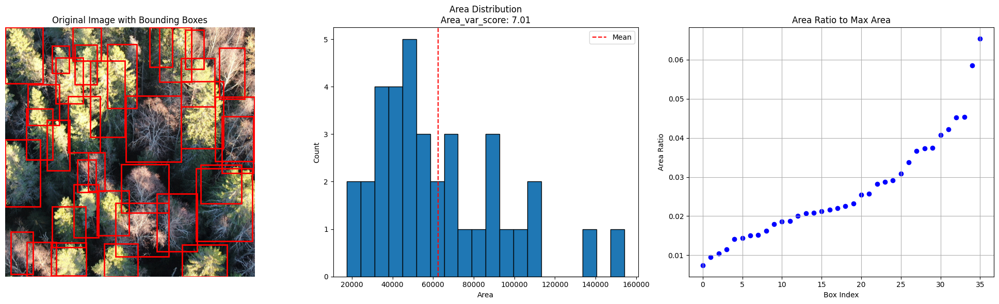

Area_var_score: 1.24


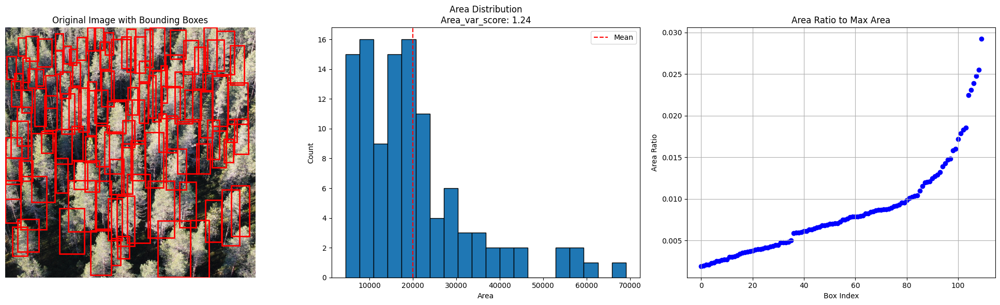

Area_var_score: 11.64


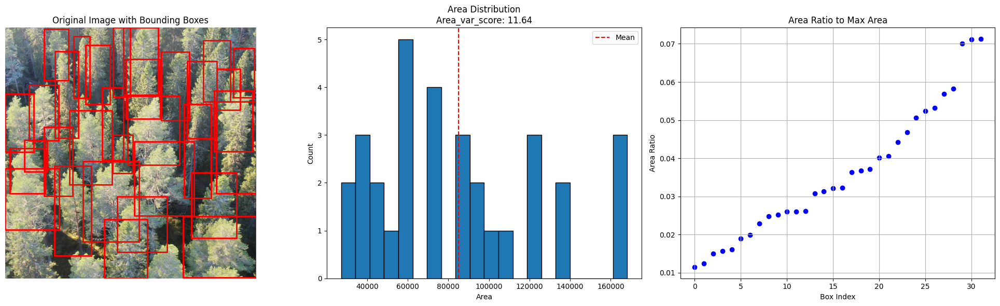

Area_var_score: 1.85


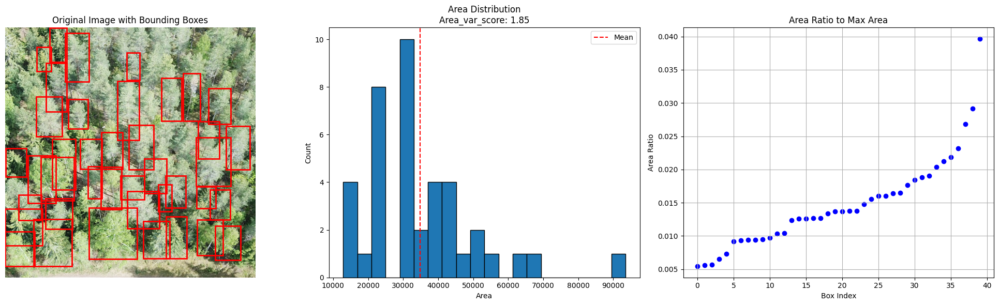

Area_var_score: 307.58


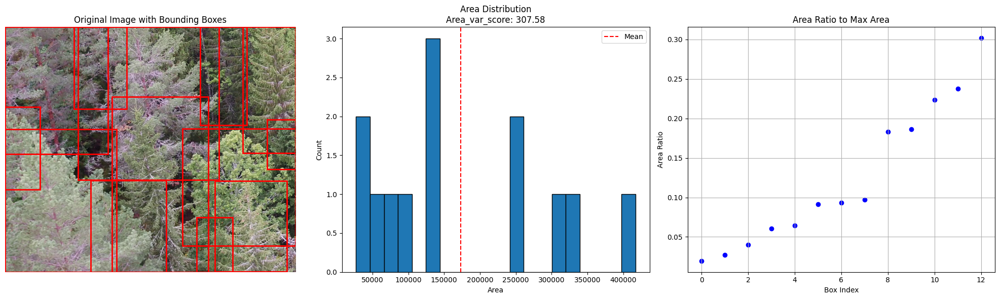

Area_var_score: 3.69


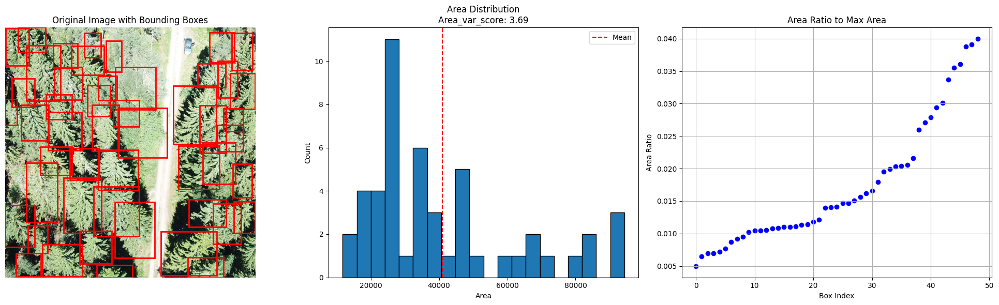

Area_var_score: 0.77


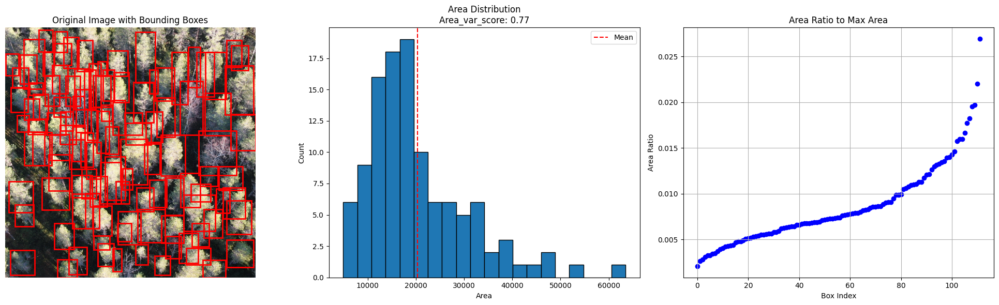

Area_var_score: 8.43


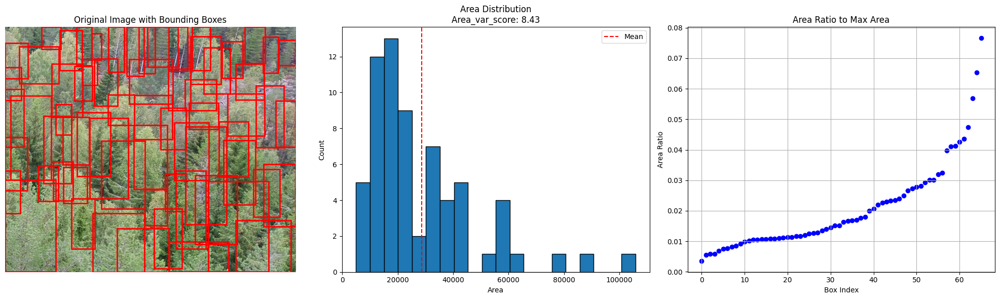

In [104]:
import numpy as np
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import os
from PIL import Image
import random

def load_coco_data(image_dir, annotation_file, n=10):
    """加载COCO格式数据"""
    coco = COCO(annotation_file)
    img_ids = coco.getImgIds()
    selected_img_ids = random.sample(img_ids, min(n, len(img_ids)))
    
    selected_images = []
    
    for img_id in selected_img_ids:
        img_info = coco.loadImgs(img_id)[0]
        img_path = os.path.join(image_dir, img_info['file_name'])
        
        ann_ids = coco.getAnnIds(imgIds=img_id)
        anns = coco.loadAnns(ann_ids)
        
        bboxes = []
        for ann in anns:
            bbox = ann['bbox']  # [x, y, width, height]
            # 转换为[x1, y1, x2, y2]格式
            bboxes.append([
                bbox[0], bbox[1], 
                bbox[0] + bbox[2], 
                bbox[1] + bbox[3]
            ])
        
        if bboxes:
            selected_images.append({
                'path': img_path,
                'width': img_info['width'],
                'height': img_info['height'],
                'bboxes': np.array(bboxes)
            })
    
    return selected_images
 
def calculate_area_variance_score(bboxes, img_shape):
    """计算边界框面积变异系数"""
    # 计算实际面积
    areas = (bboxes[:, 2] - bboxes[:, 0]) * (bboxes[:, 3] - bboxes[:, 1])
    area_var = np.var(areas) if len(areas) > 0 else 0.0
    
    # 计算理论最大方差
    max_area = img_shape[0] * img_shape[1]
    n = len(areas)
    
    if n > 0:
        n_half = n // 2
        hypothetical_areas = np.concatenate([
            np.full(n_half, max_area),
            np.zeros(n - n_half)
        ])
        sigma_a0 = np.var(hypothetical_areas)
    else:
        sigma_a0 = 1.0
    
    # 计算面积变异得分
    area_var_score = area_var / (sigma_a0 + 1e-6) *10000
    print(f"Area_var_score: {area_var_score:.2f}")
    
    return area_var_score, areas, max_area

def visualize_area_distribution(img_info):
    """可视化边界框面积分布"""
    img = Image.open(img_info['path'])
    bboxes = img_info['bboxes']
    img_shape = (img_info['height'], img_info['width'])
    
    # 计算面积变异得分
    score, areas, max_area = calculate_area_variance_score(bboxes, img_shape)
    
    # 创建图形
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))
    
    # 1. 显示原始图片和边界框
    ax1.imshow(img)
    for bbox in bboxes:
        rect = plt.Rectangle(
            (bbox[0], bbox[1]), 
            bbox[2] - bbox[0], 
            bbox[3] - bbox[1], 
            fill=False, 
            edgecolor='red', 
            linewidth=2
        )
        ax1.add_patch(rect)
    ax1.set_title('Original Image with Bounding Boxes')
    ax1.axis('off')
    
    # 2. 显示面积分布直方图
    ax2.hist(areas, bins=20, edgecolor='black')
    ax2.axvline(np.mean(areas), color='r', linestyle='dashed', label='Mean')
    ax2.set_title(f'Area Distribution\nArea_var_score: {score:.2f}')
    ax2.set_xlabel('Area')
    ax2.set_ylabel('Count')
    ax2.legend()
    
    # 3. 显示面积比例图
    sorted_areas = np.sort(areas)
    ax3.scatter(range(len(areas)), sorted_areas / max_area, c='blue')
    ax3.set_title('Area Ratio to Max Area')
    ax3.set_xlabel('Box Index')
    ax3.set_ylabel('Area Ratio')
    ax3.grid(True)
    
    plt.tight_layout()
    plt.show()

def main(image_dir, annotation_file, n=10):
    # 加载数据
    selected_images = load_coco_data(image_dir, annotation_file, n)
    
    # 为每张图片创建可视化
    for img_info in selected_images:
        visualize_area_distribution(img_info)

if __name__ == "__main__":
    image_dir = "data/ForestDamages/active_learning_ssc/images_labeled_train"
    annotation_file = "data/ForestDamages/active_learning_ssc/annotations/instances_labeled_train.json"
    main(image_dir, annotation_file, n=10)

### diversity_score


- 问题： 公式   多样性公式：e_i = -ln(1+|C_i|) × Σ[p(c_k)log p(c_k)] 

In [39]:
import numpy as np

# 模拟输入数据
labels1 = np.array([4] * 200)  # 10个框全为类别4
labels2 = np.array([1]* 11)  # 10个框全为类别1
labels3 = np.array([2]* 1)  # 10个框全为类别2
labels = np.concatenate([labels1, labels2, labels3])

print(labels)
# 计算过程
unique_labels, label_counts = np.unique(labels, return_counts=True)
label_proportions = label_counts / len(labels)
category_factor = np.log(1 + len(unique_labels))
entropy = -np.sum(label_proportions * np.log(label_proportions))
diversity_score = category_factor * entropy

print(f"类别数量因子: {category_factor:.4f}")
print(f"熵值: {entropy:.4f}")
print(f"多样性得分: {diversity_score:.4f}")

[4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 1 1 1 1 1 1 1 1 1 1 1 2]
类别数量因子: 1.3863
熵值: 0.2338
多样性得分: 0.3241


In [23]:
# 测试案例：10个框全为类别4
labels = np.array([4]*100)
unique_labels = np.unique(labels)  # [4]
label_proportions = np.array([1.0])
entropy = -np.sum(label_proportions * np.log(label_proportions + 1e-6))  # ≈0.0
diversity_score = np.log(2) * entropy  # ≈0.0
print(diversity_score)  # 输出应为0.0
print(f"{diversity_score:.4f}")  # 输出应为0.0

-6.931468339295632e-07
-0.0000


In [25]:
-0==+0==0

True

### occlusion_score

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


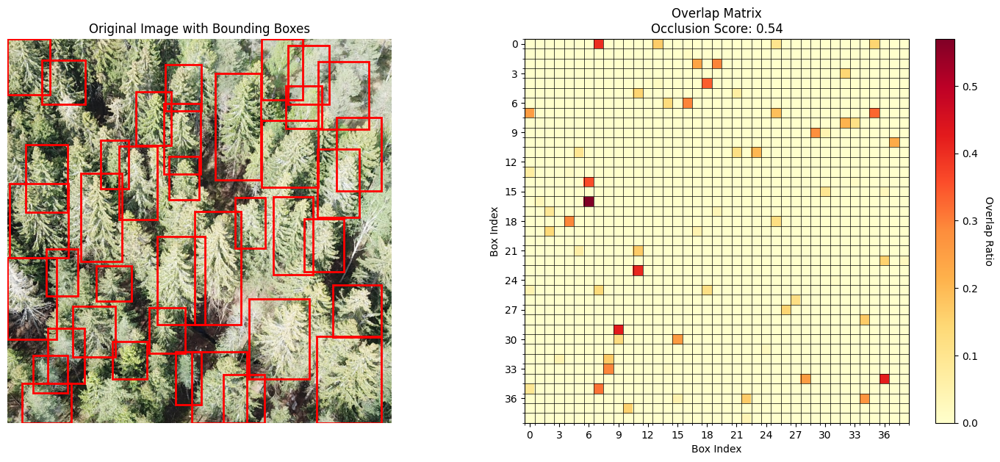

图片: 60578c07-9cce-4984-a072-1a55d5b17e66.jpg
边界框数量: 39
平均重叠率: 0.007
最大重叠率: 0.570
--------------------------------------------------
图片: 60578c07-9cce-4984-a072-1a55d5b17e66.jpg
边界框数量: 39
--------------------------------------------------


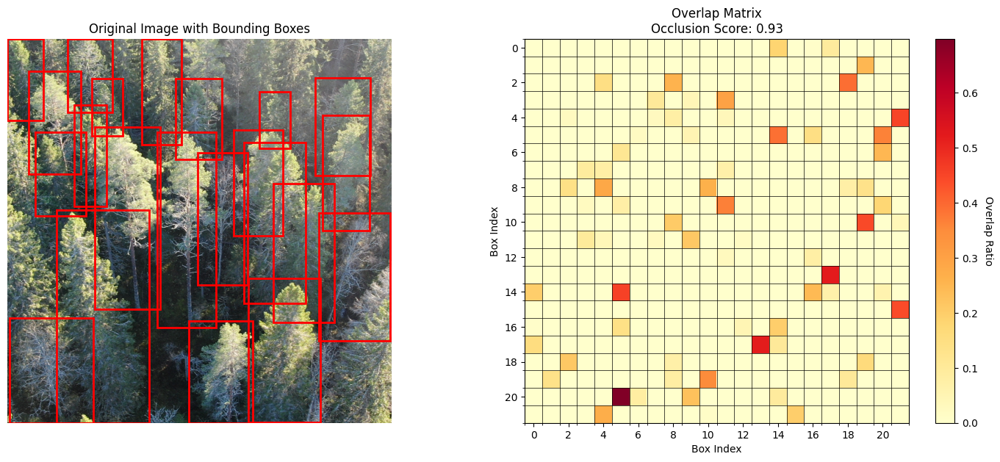

图片: 27350124-6d8e-4828-8a9a-b016c6e5e48c.jpg
边界框数量: 22
平均重叠率: 0.026
最大重叠率: 0.698
--------------------------------------------------
图片: 27350124-6d8e-4828-8a9a-b016c6e5e48c.jpg
边界框数量: 22
--------------------------------------------------


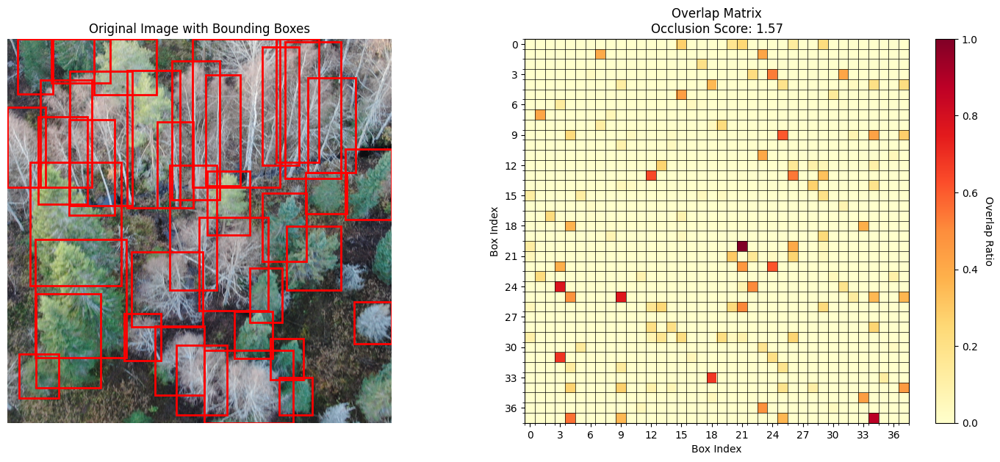

图片: e6d02db1-89bc-4ac4-995b-c5504496c74f.jpg
边界框数量: 38
平均重叠率: 0.022
最大重叠率: 1.000
--------------------------------------------------
图片: e6d02db1-89bc-4ac4-995b-c5504496c74f.jpg
边界框数量: 38
--------------------------------------------------


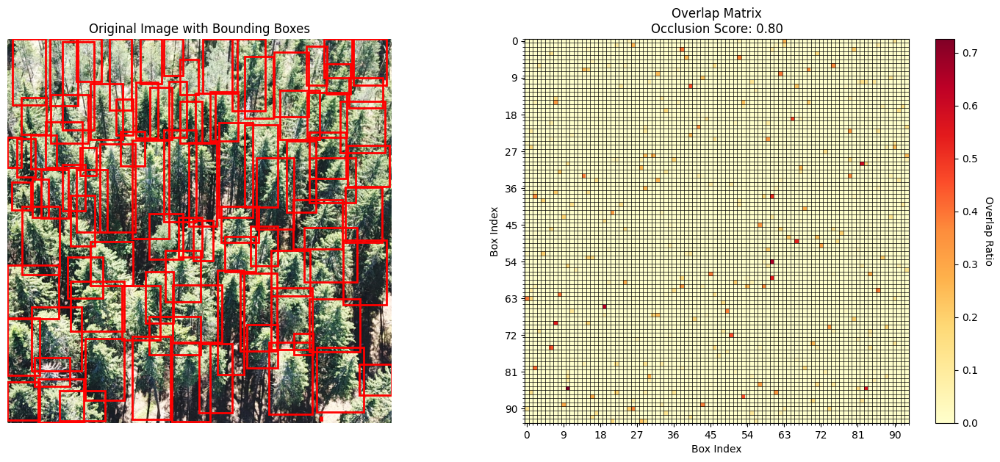

图片: fe986570-67fc-40cc-a584-46e836c87946.jpg
边界框数量: 94
平均重叠率: 0.005
最大重叠率: 0.726
--------------------------------------------------
图片: fe986570-67fc-40cc-a584-46e836c87946.jpg
边界框数量: 94
--------------------------------------------------


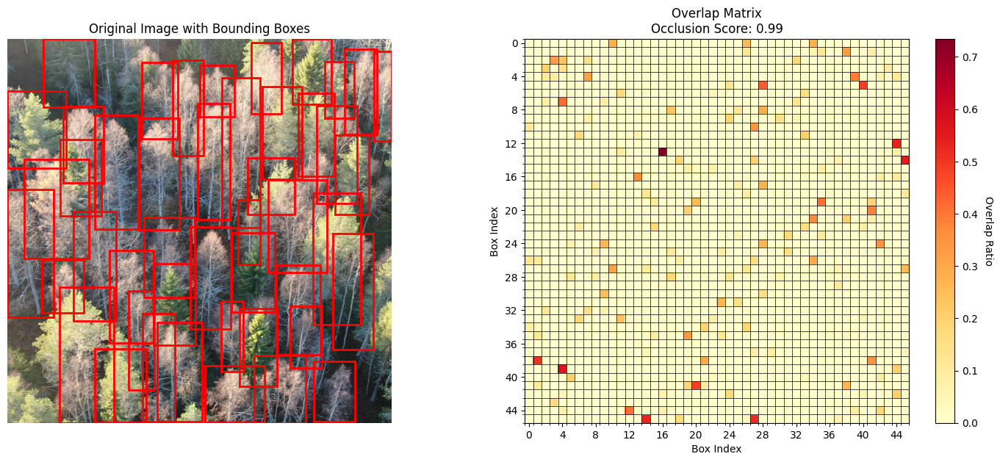

图片: 73a0cd6e-9527-4afb-a119-623ff6f83a09.jpg
边界框数量: 46
平均重叠率: 0.013
最大重叠率: 0.734
--------------------------------------------------
图片: 73a0cd6e-9527-4afb-a119-623ff6f83a09.jpg
边界框数量: 46
--------------------------------------------------


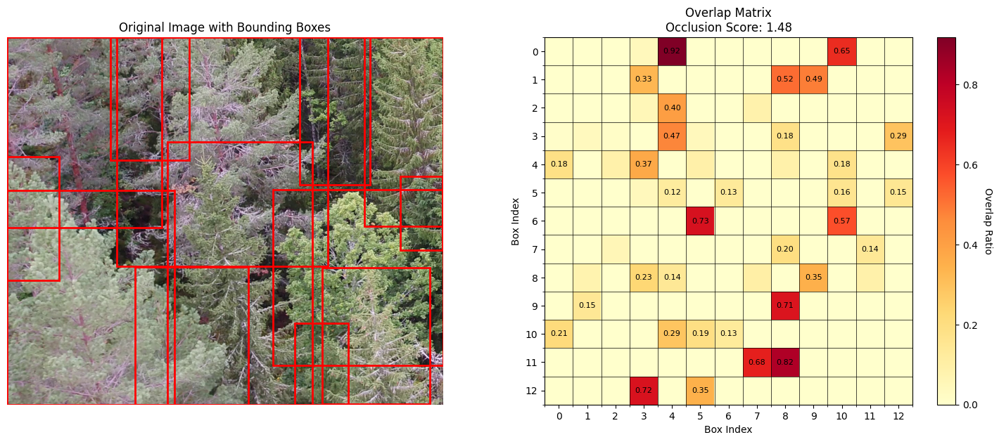

图片: 15c94626-bb3a-43d8-a15f-c99a718f807f.jpg
边界框数量: 13
平均重叠率: 0.077
最大重叠率: 0.918
--------------------------------------------------
图片: 15c94626-bb3a-43d8-a15f-c99a718f807f.jpg
边界框数量: 13
--------------------------------------------------


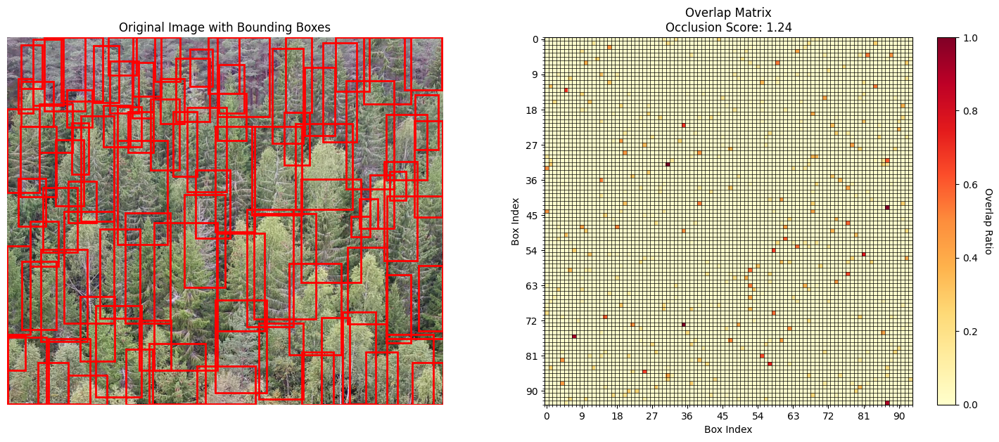

图片: 64a16fbf-60d4-4910-950b-3f1c2b47fd71.jpg
边界框数量: 94
平均重叠率: 0.009
最大重叠率: 1.000
--------------------------------------------------
图片: 64a16fbf-60d4-4910-950b-3f1c2b47fd71.jpg
边界框数量: 94
--------------------------------------------------


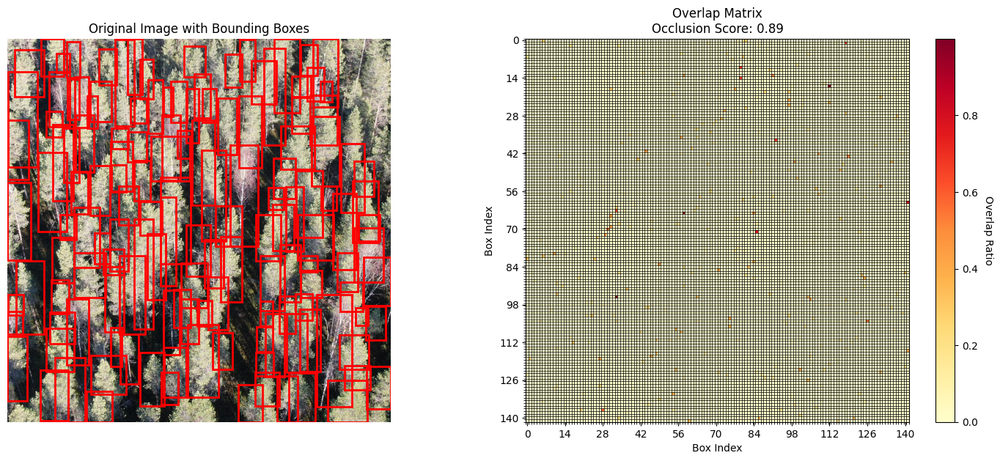

图片: bffe2693-701d-477f-8b54-ecbdf14e7693.jpg
边界框数量: 142
平均重叠率: 0.004
最大重叠率: 1.000
--------------------------------------------------
图片: bffe2693-701d-477f-8b54-ecbdf14e7693.jpg
边界框数量: 142
--------------------------------------------------


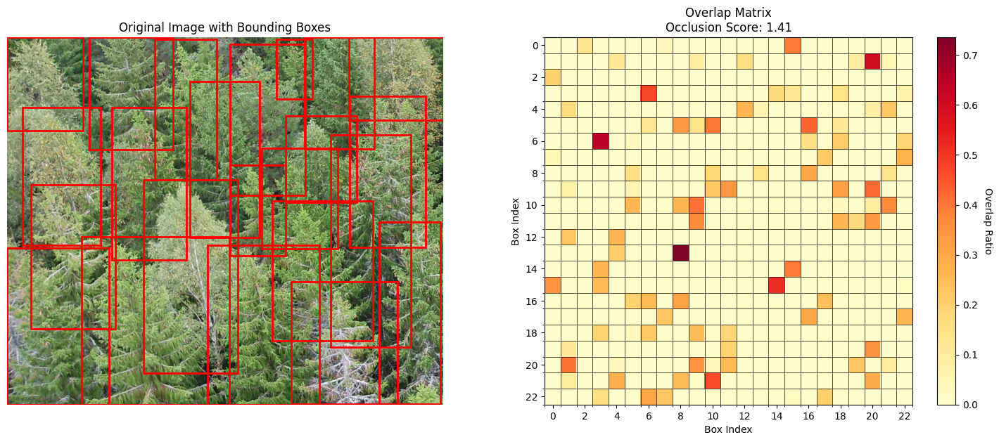

图片: 03986bb2-258d-4278-9dc0-89643372acb8.jpg
边界框数量: 23
平均重叠率: 0.042
最大重叠率: 0.736
--------------------------------------------------
图片: 03986bb2-258d-4278-9dc0-89643372acb8.jpg
边界框数量: 23
--------------------------------------------------


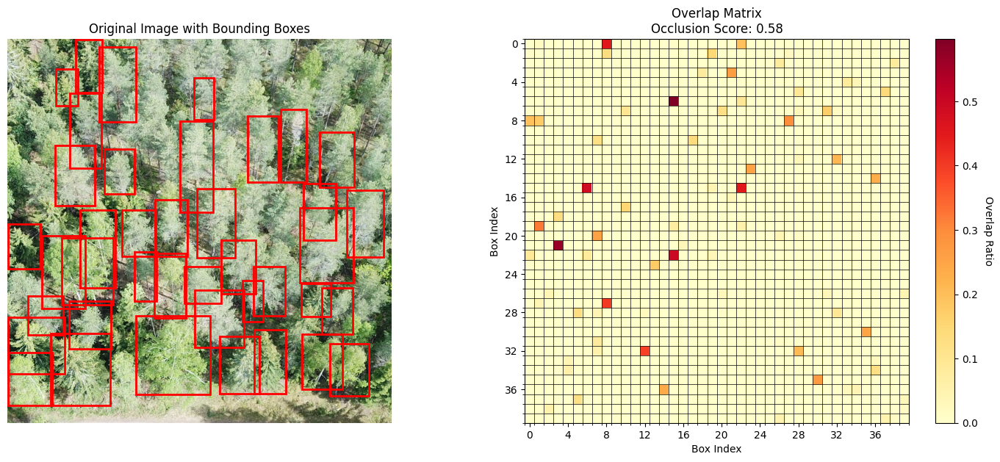

图片: 82c6a9ea-f5b3-4f28-b444-32939a3509c9.jpg
边界框数量: 40
平均重叠率: 0.007
最大重叠率: 0.597
--------------------------------------------------
图片: 82c6a9ea-f5b3-4f28-b444-32939a3509c9.jpg
边界框数量: 40
--------------------------------------------------


In [28]:
import numpy as np
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import os
from PIL import Image
import random
from typing import Dict, List

def load_coco_data(image_dir, annotation_file, n=10):
    """加载COCO格式数据"""
    coco = COCO(annotation_file)
    img_ids = coco.getImgIds()
    selected_img_ids = random.sample(img_ids, min(n, len(img_ids)))
    
    selected_images = []
    
    for img_id in selected_img_ids:
        img_info = coco.loadImgs(img_id)[0]
        img_path = os.path.join(image_dir, img_info['file_name'])
        
        ann_ids = coco.getAnnIds(imgIds=img_id)
        anns = coco.loadAnns(ann_ids)
        
        bboxes = []
        labels = []  # 添加标签列表
        for ann in anns:
            bbox = ann['bbox']  # [x, y, width, height]
            # 转换为[x1, y1, x2, y2]格式
            bboxes.append([
                bbox[0], bbox[1], 
                bbox[0] + bbox[2], 
                bbox[1] + bbox[3]
            ])
            labels.append(ann['category_id'])
        
        if bboxes:
            selected_images.append({
                'path': img_path,
                'width': img_info['width'],
                'height': img_info['height'],
                'bboxes': np.array(bboxes),
                'labels': np.array(labels)
            })
    
    return selected_images

def calculate_occlusion_score(bboxes: np.ndarray) -> float:
    """计算遮挡系数"""
    from sual.core.uncertainty.measures.utils import _calculate_sor
    
    or_values = [_calculate_sor(bboxes[i], bboxes) for i in range(len(bboxes))]
    nb_i = len(bboxes)
    if nb_i <= 5:
        k = nb_i
    else:
        alpha = 0.3  # 对应文档中的 w_OR
        k = int(alpha * nb_i)
    k = max(1, k)  # 确保 k 至少为 1
    
    sorted_or = sorted(or_values, reverse=True)
    occlusion_score = np.mean(sorted_or[:k]) if k > 0 else 0.0
    
    return occlusion_score

def visualize_occlusion(img_info: Dict):
    """可视化遮挡情况和得分"""
    img = Image.open(img_info['path'])
    bboxes = img_info['bboxes']
    from sual.core.uncertainty.measures.utils import _calculate_sor
    # 计算遮挡得分
    occlusion_score = calculate_occlusion_score(bboxes)
    
    # 创建图形
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # 1. 显示原始图片和边界框
    ax1.imshow(img)
    for bbox in bboxes:
        rect = plt.Rectangle(
            (bbox[0], bbox[1]), 
            bbox[2] - bbox[0], 
            bbox[3] - bbox[1], 
            fill=False, 
            edgecolor='red', 
            linewidth=2
        )
        ax1.add_patch(rect)
    ax1.set_title('Original Image with Bounding Boxes')
    ax1.axis('off')
    
    # 2. 显示遮挡关系矩阵（改进版）
    n_boxes = len(bboxes)
    overlap_matrix = np.zeros((n_boxes, n_boxes))
    for i in range(n_boxes):
        for j in range(n_boxes):
            if i != j:
                overlap_matrix[i, j] = _calculate_sor(bboxes[i], bboxes[j:j+1])
    
    # 使用新的显示设置
    im = ax2.imshow(overlap_matrix, cmap='YlOrRd', aspect='equal')
    
    # 添加网格线
    ax2.set_xticks(np.arange(-.5, n_boxes, 1), minor=True)
    ax2.set_yticks(np.arange(-.5, n_boxes, 1), minor=True)
    ax2.grid(which="minor", color="black", linestyle='-', linewidth=0.5)
    
    # 设置主刻度
    tick_step = max(1, n_boxes // 10)  # 动态调整刻度间隔，避免太密集
    ax2.set_xticks(np.arange(0, n_boxes, tick_step))
    ax2.set_yticks(np.arange(0, n_boxes, tick_step))
    
    # 添加颜色条
    cbar = plt.colorbar(im, ax=ax2)
    cbar.set_label('Overlap Ratio', rotation=270, labelpad=15)
    
    # 设置标题和标签
    ax2.set_title(f'Overlap Matrix\nOcclusion Score: {occlusion_score:.2f}')
    ax2.set_xlabel('Box Index')
    ax2.set_ylabel('Box Index')
    
    # 如果框的数量不太多，可以添加数值标注
    if n_boxes <= 20:  # 只在框数量较少时显示具体数值
        for i in range(n_boxes):
            for j in range(n_boxes):
                if overlap_matrix[i, j] > 0.1:  # 只显示大于0.1的值
                    text = ax2.text(j, i, f'{overlap_matrix[i, j]:.2f}',
                                  ha="center", va="center", color="black",
                                  fontsize=8)
    
    plt.tight_layout()
    plt.show()
    
    # 打印一些统计信息
    print(f"图片: {os.path.basename(img_info['path'])}")
    print(f"边界框数量: {n_boxes}")
    print(f"平均重叠率: {np.mean(overlap_matrix):.3f}")
    print(f"最大重叠率: {np.max(overlap_matrix):.3f}")
    print("-" * 50)

def main(image_dir: str, annotation_file: str, n: int = 10):
    """主函数"""
    # 加载数据
    selected_images = load_coco_data(image_dir, annotation_file, n)
    
    # 为每张图片创建可视化
    for img_info in selected_images:
        visualize_occlusion(img_info)
        print(f"图片: {os.path.basename(img_info['path'])}")
        print(f"边界框数量: {len(img_info['bboxes'])}")
        print("-" * 50)

if __name__ == "__main__":
    image_dir = "data/ForestDamages/active_learning_ssc/images_labeled_train"
    annotation_file = "data/ForestDamages/active_learning_ssc/annotations/instances_labeled_train.json"
    main(image_dir, annotation_file, n=10)

### crown_count_score 

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


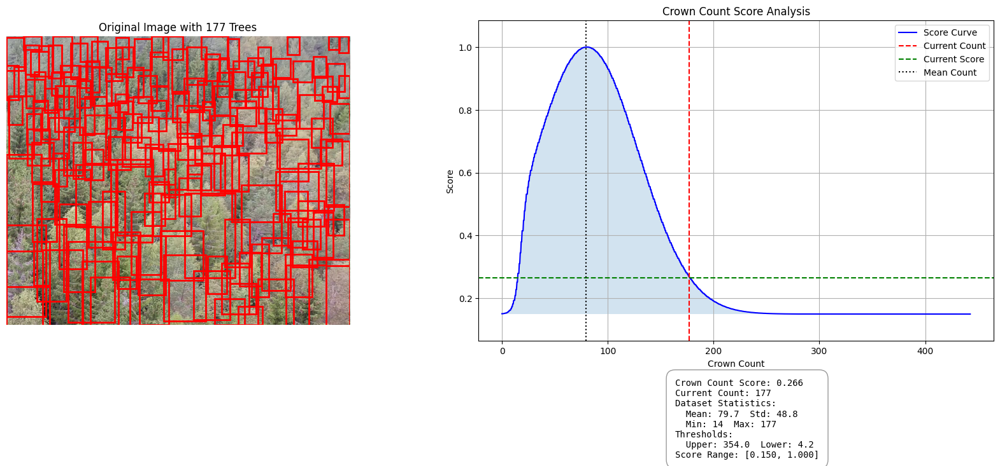

图片: 9b3de32a-1ab8-4305-a2af-574173e8d266.jpg
--------------------------------------------------


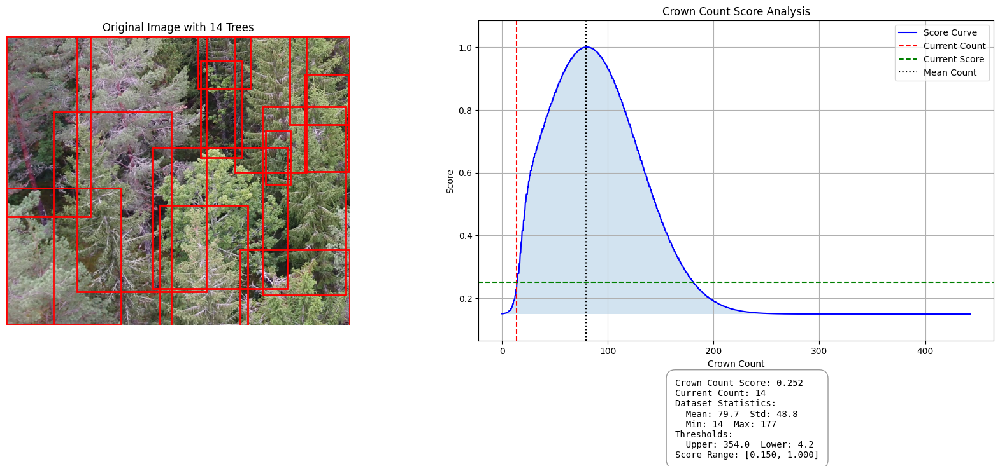

图片: 128d4e56-dce2-4749-9b02-0d9859d9b9e7.jpg
--------------------------------------------------


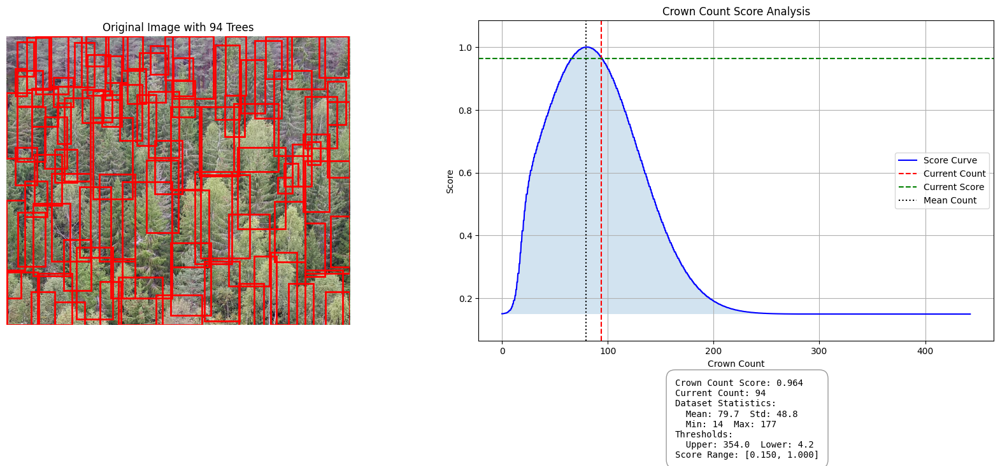

图片: 64a16fbf-60d4-4910-950b-3f1c2b47fd71.jpg
--------------------------------------------------


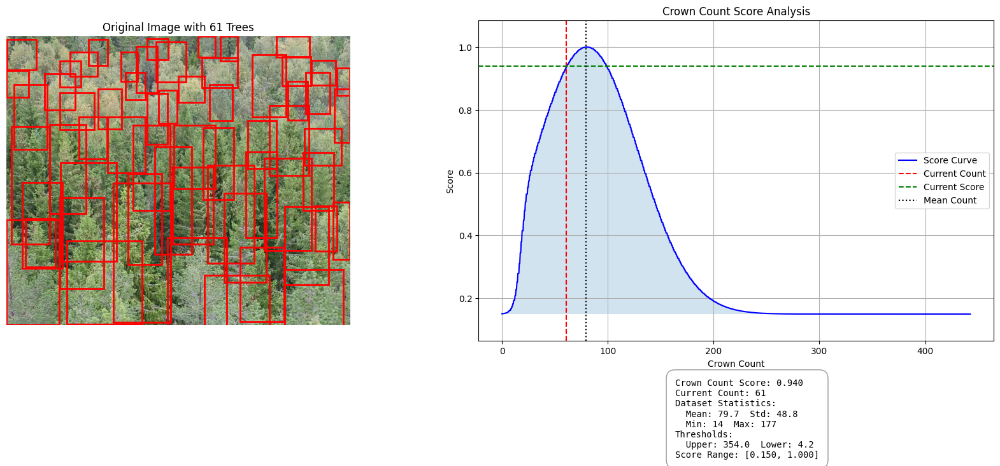

图片: 13aecbc3-47d8-4d49-a793-db340331e9ff.jpg
--------------------------------------------------


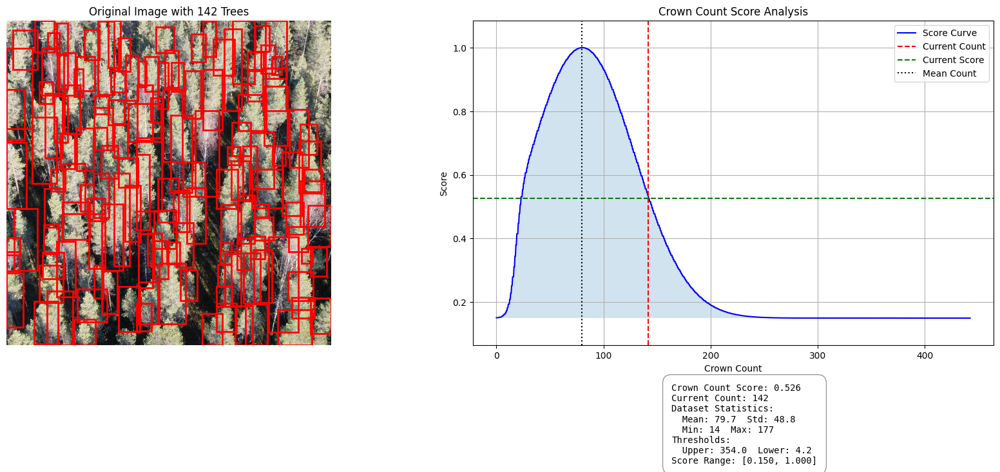

图片: bffe2693-701d-477f-8b54-ecbdf14e7693.jpg
--------------------------------------------------


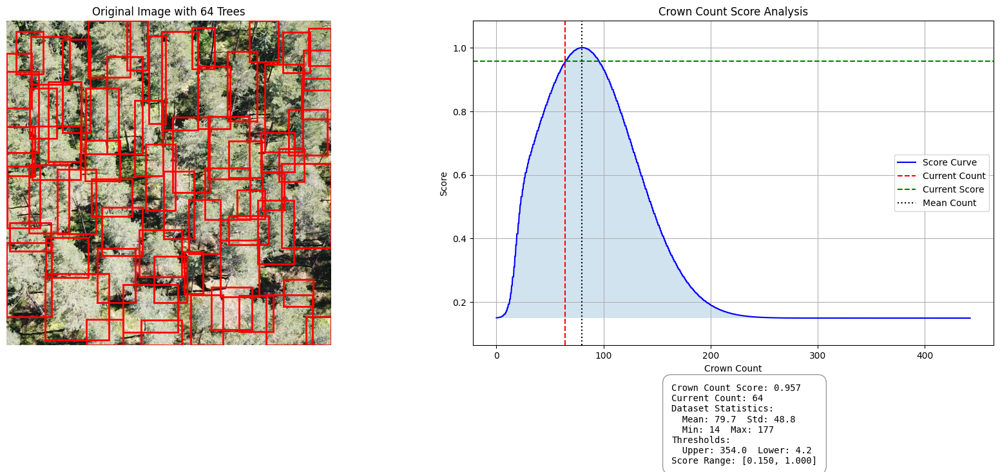

图片: e1674b10-dbe2-4cf4-9d55-b6c655337a41.jpg
--------------------------------------------------


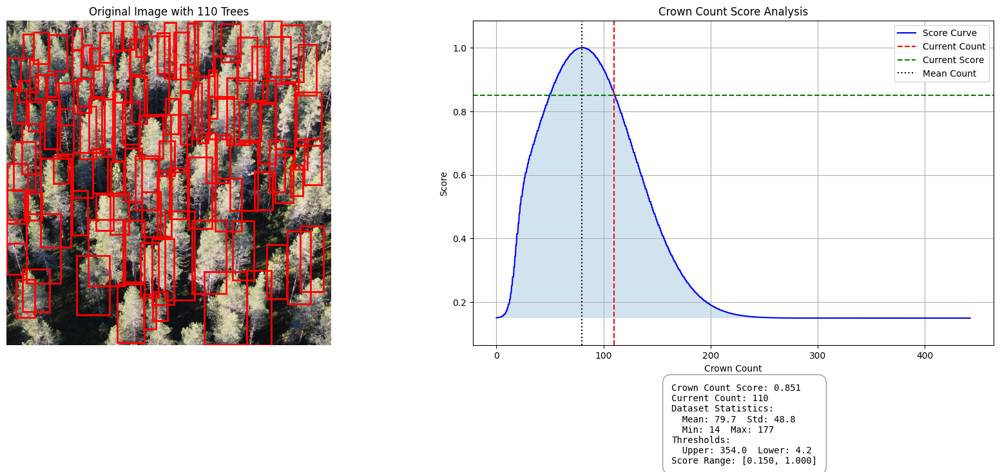

图片: e35e1e23-29c1-4c2c-8315-95def62d1d45.jpg
--------------------------------------------------


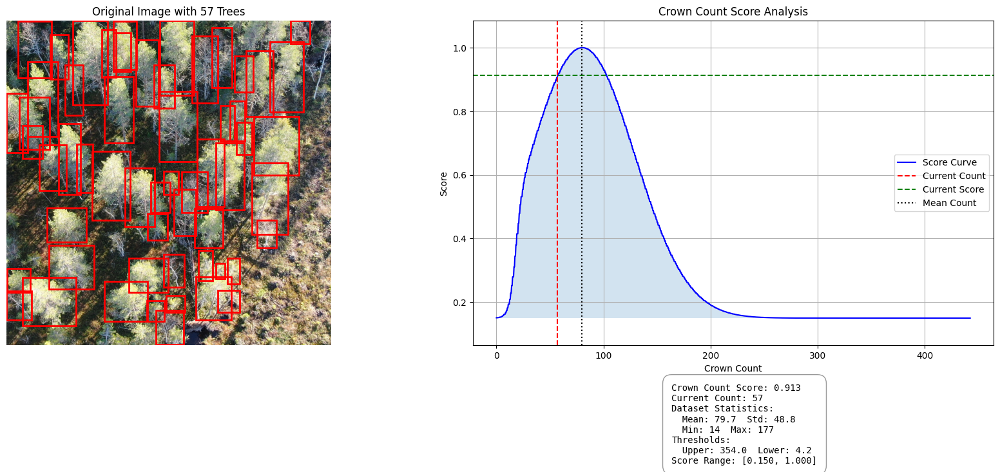

图片: 9ba7a150-4a98-4bd5-a355-fdee52aa30da.jpg
--------------------------------------------------


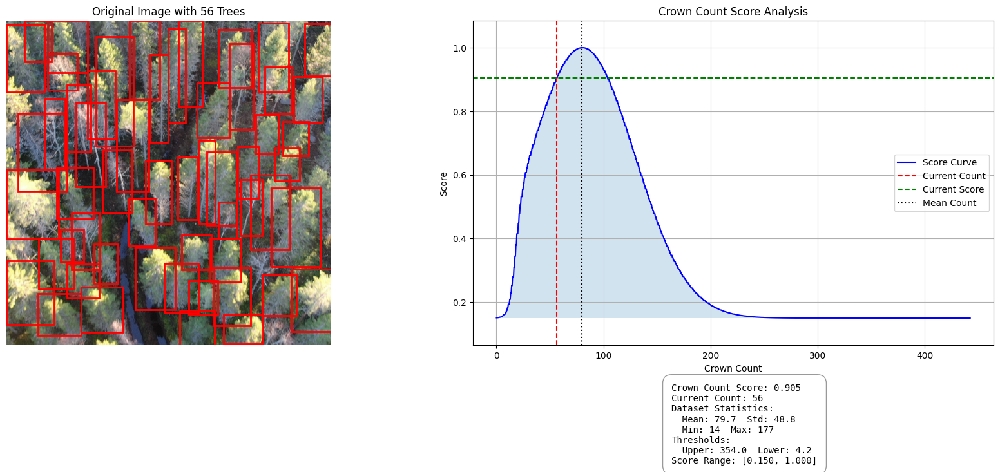

图片: aa37ca3e-f777-4f47-a8f8-a36094c2a385.jpg
--------------------------------------------------


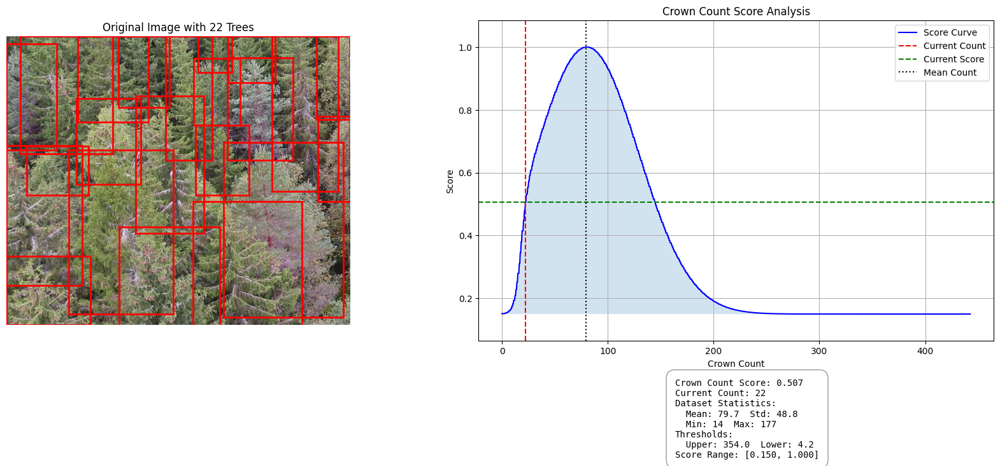

图片: e305d453-4b2a-4901-9e4c-d96438d374d6.jpg
--------------------------------------------------


In [36]:
import numpy as np
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import os
from PIL import Image
import random
from typing import Dict, List

def load_coco_data(image_dir, annotation_file, n=10):
    """加载COCO格式数据"""
    coco = COCO(annotation_file)
    img_ids = coco.getImgIds()
    selected_img_ids = random.sample(img_ids, min(n, len(img_ids)))
    
    selected_images = []
    
    for img_id in selected_img_ids:
        img_info = coco.loadImgs(img_id)[0]
        img_path = os.path.join(image_dir, img_info['file_name'])
        
        ann_ids = coco.getAnnIds(imgIds=img_id)
        anns = coco.loadAnns(ann_ids)
        
        bboxes = []
        labels = []  # 添加标签列表
        for ann in anns:
            bbox = ann['bbox']  # [x, y, width, height]
            # 转换为[x1, y1, x2, y2]格式
            bboxes.append([
                bbox[0], bbox[1], 
                bbox[0] + bbox[2], 
                bbox[1] + bbox[3]
            ])
            labels.append(ann['category_id'])
        
        if bboxes:
            selected_images.append({
                'path': img_path,
                'width': img_info['width'],
                'height': img_info['height'],
                'bboxes': np.array(bboxes),
                'labels': np.array(labels)
            })
    
    return selected_images

def calculate_crown_count_score(crown_count: int, dataset_stats: Dict) -> float:
    """计算树冠数量控制系数"""
    # 使用数据集统计信息
    n_batch = dataset_stats['mean']
    sigma_batch = dataset_stats['std']
    
    # 设置边界阈值
    upper_threshold = dataset_stats['max'] * 2.0
    lower_threshold = dataset_stats['min'] * 0.3
    
    # 计算基础高斯得分
    normalized_diff = (crown_count - n_batch) / (sigma_batch + 1e-6)
    base_score = np.exp(-0.5 * normalized_diff ** 2)
    
    # 平滑过渡参数
    transition_width = 25
    slope = 8.0
    
    # 计算平滑过渡
    upper_smooth = 1 / (1 + np.exp((crown_count - upper_threshold + transition_width/2)/transition_width*slope))
    lower_smooth = 1 / (1 + np.exp((-crown_count + lower_threshold + transition_width/2)/transition_width*slope))
    
    # 综合得分
    score = base_score * upper_smooth * lower_smooth
    
    # 提高最低得分保证
    # 强制将得分限制在[0.15, 1.0]范围内
    min_score = 0.15
    score = score * (1 - min_score) + min_score
    
    #分数截断
    score = min(1.0, max(0.15, score))
    
    return score

def visualize_crown_count_analysis(img_info: Dict, dataset_stats: Dict):
    """可视化树冠数量分析"""
    img = Image.open(img_info['path'])
    bboxes = img_info['bboxes']
    crown_count = len(bboxes)
    score = calculate_crown_count_score(crown_count, dataset_stats)
    
    # 创建两个子图，并设置合适的大小比例
    fig = plt.figure(figsize=(20, 8))
    gs = plt.GridSpec(1, 2, width_ratios=[1, 1.5], wspace=0.3)
    
    # 1. 左侧：显示原始图片和边界框
    ax1 = fig.add_subplot(gs[0])
    ax1.imshow(img)
    for bbox in bboxes:
        rect = plt.Rectangle(
            (bbox[0], bbox[1]), 
            bbox[2] - bbox[0], 
            bbox[3] - bbox[1], 
            fill=False, 
            edgecolor='red', 
            linewidth=2
        )
        ax1.add_patch(rect)
    ax1.set_title(f'Original Image with {crown_count} Trees')
    ax1.axis('off')
    
    # 2. 右侧：得分曲线
    ax2 = fig.add_subplot(gs[1])
    
    # 计算得分范围
    x = np.linspace(0, dataset_stats['max'] * 2.5, 1000)
    scores = [calculate_crown_count_score(int(i), dataset_stats) for i in x]
    y_min = min(scores)
    y_max = max(scores)
    
    # 绘制得分曲线
    ax2.plot(x, scores, 'b-', label='Score Curve')
    ax2.axvline(x=crown_count, color='r', linestyle='--', label='Current Count')
    ax2.axhline(y=score, color='g', linestyle='--', label='Current Score')
    ax2.axvline(x=dataset_stats['mean'], color='k', linestyle=':', label='Mean Count')
    ax2.fill_between(x, y_min, scores, alpha=0.2)
    
    # 设置y轴范围，留出一些边距
    margin = (y_max - y_min) * 0.1
    ax2.set_ylim(y_min - margin, y_max + margin)
    
    ax2.set_xlabel('Crown Count')
    ax2.set_ylabel('Score')
    ax2.set_title('Crown Count Score Analysis')
    ax2.grid(True)
    ax2.legend()
    
    # 在右侧图下方添加统计信息文本框
    info_text = (
        f"Crown Count Score: {score:.3f}\n"
        f"Current Count: {crown_count}\n"
        f"Dataset Statistics:\n"
        f"  Mean: {dataset_stats['mean']:.1f}  Std: {dataset_stats['std']:.1f}\n"
        f"  Min: {dataset_stats['min']}  Max: {dataset_stats['max']}\n"
        f"Thresholds:\n"
        f"  Upper: {dataset_stats['max'] * 2.0:.1f}  Lower: {dataset_stats['min'] * 0.3:.1f}\n"
        f"Score Range: [{y_min:.3f}, {y_max:.3f}]"  # 添加得分范围信息
    )
    
    plt.figtext(0.65, 0.02, info_text,
                fontsize=10,
                fontfamily='monospace',
                bbox=dict(facecolor='white', 
                         alpha=0.8,
                         edgecolor='gray',
                         boxstyle='round,pad=1'))
    
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.25)
    plt.show()

def main(image_dir: str, annotation_file: str, n: int = 10):
    """主函数"""
    # 加载数据
    selected_images = load_coco_data(image_dir, annotation_file, n)
    
    # 计算数据集统计信息
    all_counts = [len(img_info['bboxes']) for img_info in selected_images]
    # 这个批次的树冠数量统计信息
    dataset_stats = {
        'mean': float(np.mean(all_counts)),
        'std': float(np.std(all_counts)),
        'min': int(np.min(all_counts)),
        'max': int(np.max(all_counts))
    }
    
    # 为每张图片创建可视化
    for img_info in selected_images:
        visualize_crown_count_analysis(img_info, dataset_stats)
        print(f"图片: {os.path.basename(img_info['path'])}")
        print("-" * 50)

if __name__ == "__main__":
    image_dir = "data/ForestDamages/active_learning_ssc/images_labeled_train"
    annotation_file = "data/ForestDamages/active_learning_ssc/annotations/instances_labeled_train.json"
    main(image_dir, annotation_file, n=10)